# Welcome to the Final Project!

Course: https://courses.thinkautonomous.ai/obstacle-tracking

In this project, you will learn to associate bounding boxes on multiple frames using the Hungarian Algorithm!


You will work on 3 aspects of the **multi-object tracker**:

*   Use YOLO and launch an object detection algorithm
*   Use The Hungarian Algorithm and associate the boxes
*   Improve the algorithm to avoid false positives and false negatives


This is a part included to link your Google Colab file (.ipynb) to your Google Drive folder.

If you don't work on Colab, you won't need these.

In [1]:
import os
from google.colab import drive
drive.mount('/content/drive', force_remount=False)

os.chdir("/content/drive/My Drive/tracking_course/Final_Project")
!ls

Mounted at /content/drive
final_project_Starter.ipynb  __pycache__	   yolo_nms.py	    Yolov3
Images			     yolo_for_tracking.py  yolo_starter.py


# 1 - Detection

In order to make multi-object tracking work, we will need to do a detection step. The tracking will heavily rely on the detector, it better be good.

We will choose the [YOLO algorithm](https://pjreddie.com/darknet/yolo/) that is both accurate and fast.

<img src="https://miro.medium.com/max/1446/1*YpNE9OQeshABhBgjyEXlLA.png" width="500">


Eventually, we want bounding box detection

<img src="https://pjreddie.com/media/image/Screen_Shot_2018-03-24_at_10.48.42_PM.png" width="500">


## Import Libraries and Test Images

Let's import the libraries and test images.<p>
I took a video and wrote a short script to take a picture every 7 frame of the image. Instead of working at **60 FPS** (recording frame rate), consider you have an algorithm working at 60/7 or about **9 frame per second**.<p>_

**Why the cut ?**<p>
YOLO is very fast, it can work at 60 FPS.
For tracking to be a bit challenging, let's not have 99% IOU every time.

In [2]:
### Imports
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import copy
import pickle
import cv2
import numpy as np
from yolo_nms import *

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
### Load the Images
dataset_images = pickle.load(open('Images/images_tracking.p', "rb"))

In [4]:
def visualize_images(input_images):
    fig=plt.figure(figsize=(100,100))

    for i in range(len(input_images)):
        fig.add_subplot(1, len(input_images), i+1)
        plt.imshow(input_images[i])
    plt.show()

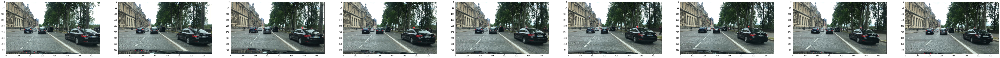

In [5]:
visualize_images(dataset_images)

## Run Initial Obstacle Detection - Modify the YOLO file

We will need to modify the original yolo.py file. Go to this file, **duplicate it**, and **modify the duplicate online** using Google Drive's text editor. <p>_

**What modifications should you do?**<p>
The current *inference()* function outputs an image.
To work with the hungarian algorithm, we will need the bounding box.<p>
* **Modify the postprocess()** function as well as the **inference() function** to **return the bounding box**.
* Then, we will only work with the original image and the bounding boxes
* Call the new file **yolo_modified.py**
 and import it

In [6]:
### Run obstacle detection for the images
from yolo_starter import *

## RUN OBSTACLE DETECTION ON EACH IMAGE; STORE THE RESULTS IN A LIST OF IMAGES, AND A LIST OF BOXES
## YOUR CODE HERE
yolo = YOLO()
images = []
frame_boxes = []  # bounding boxes in reach frame

dataset_images1 = copy.deepcopy(dataset_images)

for image in dataset_images1:
  img, boxes = yolo.inference(image)
  images.append(img)
  frame_boxes.append(boxes)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


[[474, 210, 295, 156], [217, 213, 38, 31], [265, 212, 65, 55], [151, 210, 73, 50], [111, 211, 14, 22], [341, 205, 50, 46]]
[[466, 209, 306, 151], [212, 215, 41, 32], [260, 213, 67, 54], [145, 210, 76, 50], [103, 213, 13, 22], [339, 202, 42, 46], [255, 217, 14, 12]]
[[468, 207, 301, 154], [217, 211, 39, 31], [262, 212, 69, 53], [153, 209, 70, 51], [653, 206, 20, 24], [104, 208, 14, 22], [344, 203, 45, 44]]
[[469, 214, 297, 143], [218, 217, 41, 29], [267, 211, 66, 57], [680, 205, 23, 40], [151, 212, 70, 53], [102, 213, 14, 24], [712, 213, 19, 44], [343, 209, 51, 42]]
[[474, 212, 287, 142], [225, 213, 41, 32], [718, 201, 27, 58], [268, 212, 72, 55], [154, 211, 69, 55], [536, 206, 16, 16], [353, 204, 44, 41], [751, 199, 15, 67], [103, 209, 16, 26], [424, 212, 9, 20]]
[[460, 204, 273, 147], [741, 189, 25, 87], [217, 211, 42, 32], [151, 210, 73, 48], [90, 207, 15, 27], [264, 210, 67, 55], [344, 204, 44, 40], [424, 209, 8, 25], [388, 211, 9, 24]]
[[456, 204, 263, 147], [216, 210, 43, 30], [26

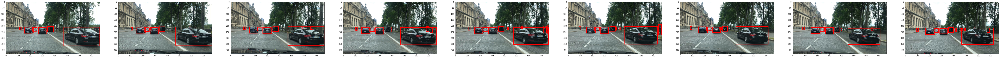

In [7]:
# Print the results and the detected boxes
## YOUR CODE HERE
for boxes in frame_boxes:
  print(boxes)

visualize_images(images)

## One Obstacle - One Color
**Last Step!** <p>
We now one one color per bounding box! All cars in blue is useless! <p>
We will create an Obstacle class that we will modify.
Each detected obstacle should have:
* an id
* a current bounding box
* a previous bounding box<p>_

**In the end, we will draw a bounding box based on the id.** <p>
If the id changes, the color will change also.

In [8]:
class Obstacle():
    def __init__(self, idx, box):
        """
        Init function. The obstacle must have an id and a box.
        """
        self.idx = idx
        self.box = box

In [9]:
def id_to_color(idx):
    """
    Random function to convert an id to a color
    Do what you want here but keep numbers below 255
    """
    blue = idx*5 % 256
    green = idx*36 %256
    red = idx*23 %256
    return (red, green, blue)

In [10]:
def main():
    """
    Main function.
    You already ran the detector on all 9 images. The variable is result_boxes.
    Use this to assign an id and draw a rectangle based on the id.
    """
    ## YOUR CODE HERE
    result_images = []
    obstacles = []
    id = 0
    dataset_images1 = copy.deepcopy(dataset_images)
    for i in range(len(frame_boxes)):
      frame = dataset_images1[i]
      boxes = frame_boxes[i]
      for j in range(len(boxes)):
        left = boxes[j][0]
        top = boxes[j][1]
        width = boxes[j][2]
        height = boxes[j][3]
        right = left + width
        bottom = top + height

        id += 1
        obj = Obstacle(id, boxes[i])
        color = id_to_color(id+1)
        cv2.rectangle(frame, (left, top), (right, bottom), color, 3)
        # Get the id of each bounding box
        text = "{}".format(id)
        
        #Display the ID at the top of the bounding box
        cv2.putText(frame, text, (left, top), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 2)

        obstacles.append(obj)
      result_images.append(frame)
    return result_images

result_images_2 = main()

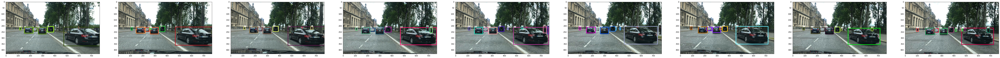

In [11]:
## Print the results
visualize_images(result_images_2)

We did it!<p>...<p>

But as you can see, the colors are not kept along the images. **We don't have active tracking yet**!

# 2 - Association

We now have a detection algorithm working! Congratulations!
The next step is to **match the detections** from one frame to another and **keep the color along the 9 images**.<p>
It should be dynamic and **work no matter the number of images**. In the end, we'll apply **this algorithm on a video**.

Eventually, we'll want a good association system

![Texte alternatif…](https://miro.medium.com/proxy/0*yN9MllhmuglJORss.png)

## Metrics

The first thing we'll need is to define a metric!

* If you **don't want a big challenge**, the **IOU cost** will do just fine!
* If you want a **medium challenge**, you can try to **implement [this paper](https://arxiv.org/pdf/1709.03572.pdf)**. Read carefully page 19-20 and try to implement these costs with IOU. It will filter out incoherent boxes.
* If you want the **biggest challenge**, try to **code [Deep SORT](https://arxiv.org/pdf/1703.07402.pdf)** and associate Deep Convolutional features to it. <p>

In the end, you should have a **single number in the cost matrix**. And it should be representative of the cost, like IOU is.

### IOU COST

In [12]:
def convert_data(box):
    """
    Convert data from (x1,y1, w, h) to (x1,y1,x2,y2)
    """
    x1 = box[0]
    x2 = box[0] + box[2]
    y1 = box[1]
    y2 = box[1]+box[3]
    return x1,y1,x2,y2

def box_iou(box1, box2):
    """
    Computer Intersection Over Union cost
    """
    box1 = convert_data(box1)
    box2 = convert_data(box2)
    xA = max(box1[0], box2[0])
    yA = max(box1[1], box2[1])
    xB = min(box1[2], box2[2])
    yB = min(box1[3], box2[3])

    inter_area = max(0, xB - xA + 1) * max(0, yB - yA + 1) #abs((xi2 - xi1)*(yi2 - yi1))
    # Calculate the Union area by using Formula: Union(A,B) = A + B - Inter(A,B)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1) #abs((box1[3] - box1[1])*(box1[2]- box1[0]))
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1) #abs((box2[3] - box2[1])*(box2[2]- box2[0]))
    union_area = (box1_area + box2_area) - inter_area
    # compute the IoU
    iou = inter_area/float(union_area)
    return iou

### Exponential, Linear, And IOU Costs

Use this paper to code the solution: https://arxiv.org/pdf/1709.03572.pdf

In [13]:
## CREATE A FUNCTION HUNGARIAN_COST THAT OUTPUTS THE HUNGARIAN COST AS IN THE PAPER
## BE CAREFUL NOT TO DIVIDE BY ZERO
def c_lin(XA, YA, WA, HA, XB, YB, WB, HB):
  '''
  calculate the linear cost
  '''
  (_ , w, h, _) = np.array(dataset_images).shape
  Q_dist = np.linalg.norm(np.array([w, h]))
  Q_shp = w * h
  d1 = np.linalg.norm(np.array([XA-XB, YA-YB]))
  d2 = np.linalg.norm(np.array([HA-HB, WA-WB]))
  
  if d1 == 0.0:
    d1 = 0.0001 
  if d2 == 0.0:
    d2 = 0.0001 
  cost = (Q_dist / d1) * (Q_shp / d2)
  return cost

def c_exp(XA, YA, WA, HA, XB, YB, WB, HB):
  '''
  calculate the exponential cost
  '''
  w1 = 0.5
  w2 = 1.5
  p1 = ((XA-XB) / WA)**2 + ((YA-YB) / HA)**2
  p2 = abs(HA - HB) / (HA + HB) + abs(WA - WB) / (WA + WB)
  cost = np.exp(-w1 * p1) * np.exp(-w2 * p2)
  return cost


## YOUR CODE HERE
def hungarian_cost(old_boxes, new_boxes, iou_thresh=0.3, linear_thresh=10000, exp_thresh=0.5):
    cost_matrix = []
    for box1 in old_boxes:
      row = []
      for box2 in new_boxes:
        iou_cost = box_iou(box1, box2)
        XA = box1[0] + box1[2] * 0.5
        YA = box1[1] + box1[3] * 0.5
        WA = box1[2]
        HA = box1[3]
        XB = box2[0] + box2[2] * 0.5
        YB = box2[1] + box2[3] * 0.5
        WB = box2[2]
        HB = box2[3]
        lin_cost = c_lin(XA, YA, WA, HA, XB, YB, WB, HB)
        exp_cost = c_exp(XA, YA, WA, HA, XB, YB, WB, HB)
        
        if (iou_cost >= iou_thresh and lin_cost >= linear_thresh and exp_cost >= exp_thresh):
          row.append(iou_cost)
        else:
          row.append(0)
      cost_matrix.append(row)

    return cost_matrix

## The Hungarian Algorithm
We can now use the previous code from the workshop to track bounding boxes!

* Create an **associate()** function that takes **two lists of boxes** (time t-1 and time t) and that outputs **the matches, the new detections, and the unmatched tracks**.

In [14]:
from scipy.optimize import linear_sum_assignment

def associate(old_boxes, new_boxes):
    """
    old_boxes will represent the former bounding boxes (at time 0)
    new_boxes will represent the new bounding boxes (at time 1)
    Function goal: Define a Hungarian Matrix with IOU as a metric and return, for each box, an id
    RETURN: Matches, Unmatched Detections, Unmatched Trackers
    """
    ## YOUR CODE HERE
    iou_matrix = np.array(hungarian_cost(old_boxes, new_boxes))

    # We are having the maximization problem, we want to take the maximum cost.
    # But the Hungarian algorithm works with minimization problem. It takes
    # the minimum distance, or minimum numbers in the matrix
    hungarian_row, hungarian_col = linear_sum_assignment(-iou_matrix)

    matches = []
    unmatched_trackers = []
    unmatched_detections = []

    for i in range(len(hungarian_row)):
      x = hungarian_row[i]
      y = hungarian_col[i]
      if iou_matrix[x][y] < 0.3:
        unmatched_trackers.append(x)
        unmatched_detections.append(new_boxes[y])
      else:
        matches.append([x,y])
    
    # Since the number of old_boxes and the number of new_boxes is not always the same,
    # but the length of hungarian_row and hungarian_col will be the same,
    # so there might be some of the untracked or new_detected not been append to the list
    for t, track in enumerate(old_boxes):
      if t not in hungarian_row:
        unmatched_trackers.append(t)

    for d, det in enumerate(new_boxes):
      if d not in hungarian_col:
        unmatched_detections.append(det)
    
    return matches, unmatched_trackers, unmatched_detections  

## Main Loop

In [15]:
def main(input_image):
    """
    Receives an images
    Outputs the result image, and a list of obstacle objects 
    """
    ## YOUR CODE HERE
    global stored_obstacles
    global idx

    image = copy.deepcopy(input_image)
    _, bounding_boxes = yolo.inference(image)

    # see if this is the first
    # since we start the idx from 0, if this is the first image, idx will be 0
    if idx == 0:
      stored_obstacles = []
      for box in bounding_boxes:
        # assign idx to each box
        obj = Obstacle(idx, box)
        stored_obstacles.append(obj)
        # draw the bounding box on image
        left, top, right, bottom = convert_data(box)
        color = id_to_color(idx)
        image = cv2.rectangle(image, (left, top), (right, bottom), color, 7)
        # display the idx at the top of the bounding box
        text = "{}".format(idx)
        cv2.putText(image, text, (left, top), cv2.FONT_HERSHEY_SIMPLEX, 2, color, 3)
        idx += 1
      return image, stored_obstacles
    
    else:
      # get previous frame boxes
      previous_boxes = [obj.box for obj in stored_obstacles]
      # do association between new detected boxes and previous detected boxes
      matches, unmatched_trackers, unmatched_detections = associate(previous_boxes, bounding_boxes)

      new_obstacles = []
      # for matched boxes, store it to the new_obstacles list
      # matches is an array store matched boxes index [[index of pre_boxes, index of cur_boxes], [1,2] , [2,3]...]
      for match in matches:
        obj = Obstacle(stored_obstacles[match[0]].idx, bounding_boxes[match[1]])
        new_obstacles.append(obj)
        
      for new_box in unmatched_detections:
        # if we have new detected obstacles, assign an idx to it
        obj = Obstacle(idx, new_box)
        new_obstacles.append(obj)
        idx += 1
        
      
      # draw bounding boxes on image
      for obj in new_obstacles:
        new_idx = obj.idx
        box = obj.box
        left, top, right, bottom = convert_data(box)
        color = id_to_color(new_idx)
        image = cv2.rectangle(image, (left, top), (right, bottom), color, 7)
        text = "{}".format(new_idx)
        cv2.putText(image, text, (left, top), cv2.FONT_HERSHEY_SIMPLEX, 2, color, 3)
    
      stored_obstacles = new_obstacles
      return image, stored_obstacles
    

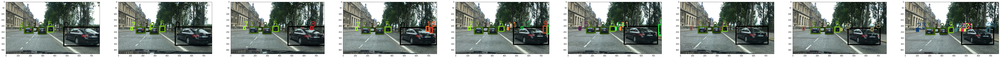

In [16]:
### Call the main loop

yolo = YOLO()
idx = 0

fig=plt.figure(figsize=(100,100))

result_images_3 = copy.deepcopy(dataset_images)

out_imgs = []

for i in range(len(result_images_3)):
    out_img, stored_obstacles = main(result_images_3[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(result_images_3), i+1)
    plt.imshow(out_imgs[i])

plt.show()

# 3 - Improvement

### Changing the Non Maxima Suppression formula

In OpenCV DNN, NMS (Non Maxima Suppression) is computer per class, insteaf of on the whole list. For that reason, we may arrive at unwanted results:
![](https://user-images.githubusercontent.com/25801568/79720833-01a88180-82ea-11ea-993b-8accd6b7fcc1.png)

I have found a new Non-Maxima Suppression formula we can use [on PyImageSearch's page](https://www.pyimagesearch.com/2015/02/16/faster-non-maximum-suppression-python/).

We have to adapt it:

*   We have (x1,y1,w,h) and we the function takes (x1,y1, x2, y2)
*   That's it!



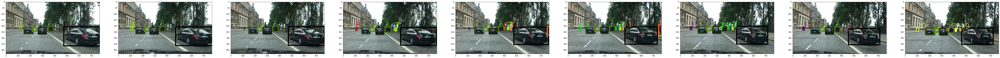

In [17]:
# from yolo_nms import *

yolo = YOLOV2()
idx = 0

fig=plt.figure(figsize=(100,100))

result_images_3 = copy.deepcopy(dataset_images)

out_imgs = []

for i in range(len(result_images_3)):
    out_img, stored_obstacles = main(result_images_3[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(result_images_3), i+1)
    plt.imshow(out_imgs[i])

## TODO: Run this and compare the results!

### Using Age

We now have a pretty good tracker! <p>
One thing that is not very good is that it relies solely on the detector.
If we miss the detection, we miss everything. <p>

In this part, we'll introduce two ideas:
* False Positive
* False Negative<p>

A **false positive** means that you detected an obstacle that shouldn't detect.<p>
We'll solve it by introducing a **MIN_HIT_STREAK** variable. If the detector detects something once, it is not displayed. If it **detects it twice in a row**, or 3 times in a row (thanks to matching), it is displayed.

A **false negative** means that you didn't detect an obstacle that should have been detected.<p>
We'll solve it by introducing a **MAX_AGE** variable. If an obstacle is suddently unmatched, we **keep displaying** it. If it is unmatched again, or more times, we remove it.

In [18]:
MIN_HIT_STREAK = 4
MAX_UNMATCHED_AGE = 4

**Obstacle Class** <p>
Let's redefine the Obstacle class to include these values
Every obstacle should have:
* an id
* a box
* an age (number of times matched)
* an unmatched frame number (number of times unmatched)

In [19]:
class Obstacle():
    def __init__(self, idx, box, age=1, unmatched_age=0):
        self.idx = idx
        self.box = box
        ## ADD AGE AND UNMATCHED AGE
        ## YOUR CODE HERE
        self.age = age
        self.unmatched_age = unmatched_age

**Main Loop**<p>
Now we can redefine the main loop
We simply add conditions to display or not an obstacle

In [20]:
def main(input_image):
    """
    Receives an images
    Outputs the result image, and a list of obstacle objects 
    """
    ## MODIFY THE MAIN FUNCTION TO NOW CONSIDER AGE AND UNMATCHED AGE
    global stored_obstacles
    global idx

    image = copy.deepcopy(input_image)
    _, bounding_boxes = yolo.inference(image)

    # see if this is the first
    # since we start the idx from 0, if this is the first image, idx will be 0
    if idx == 0:
      stored_obstacles = []
      for box in bounding_boxes:
        # assign idx to each box
        obj = Obstacle(idx, box)
        stored_obstacles.append(obj)
        # draw the bounding box on image
        # left, top, right, bottom = convert_data(box)
        # color = id_to_color(idx)
        # image = cv2.rectangle(image, (left, top), (right, bottom), color, 7)
        # display the idx at the top of the bounding box
        # text = "{}".format(idx)
        # cv2.putText(image, text, (left, top), cv2.FONT_HERSHEY_SIMPLEX, 2, color, 3)
        idx += 1
      return image
    
    else:
      # get previous frame boxes
      previous_boxes = [obj.box for obj in stored_obstacles]
      # do association between new detected boxes and previous detected boxes
      matches, unmatched_trackers, unmatched_detections = associate(previous_boxes, bounding_boxes)

      new_obstacles = []
      selected_obstacles = []   # this is gonna work with condition
      # for matched boxes, store it to the new_obstacles list
      # matches is an array store matched boxes index [[index of pre_boxes, index of cur_boxes], [1,2] , [2,3]...]
      for match in matches:
        obj = Obstacle(stored_obstacles[match[0]].idx, bounding_boxes[match[1]], stored_obstacles[match[0]].age+1)
        new_obstacles.append(obj)
        if obj.age >= MIN_HIT_STREAK:
          selected_obstacles.append(obj)
        
      for new_box in unmatched_detections:
        # if we have new detected obstacles, assign an idx to it
        obj = Obstacle(idx, new_box)
        new_obstacles.append(obj)
        idx += 1

      for index in unmatched_trackers:
        obj = stored_obstacles[index]
        obj.unmatched_age += 1
        if obj.unmatched_age < MAX_UNMATCHED_AGE:
          selected_obstacles.append(obj)
          new_obstacles.append(obj)
      
      # draw bounding boxes on image
      for obj in selected_obstacles:
        new_idx = obj.idx
        box = obj.box
        left, top, right, bottom = convert_data(box)
        color = id_to_color(new_idx)
        image = cv2.rectangle(image, (left, top), (right, bottom), color, 3)
        text = "{}".format(new_idx)
        image = cv2.putText(image, text, (left, top), cv2.FONT_HERSHEY_SIMPLEX, 2, color, 3)
    
      stored_obstacles = copy.deepcopy(new_obstacles)
      return image

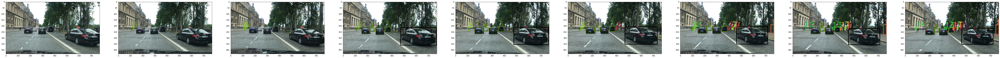

In [21]:
yolo = YOLOV2()
idx = 0

fig=plt.figure(figsize=(100,100))

result_images_3 = copy.deepcopy(dataset_images)

out_imgs = []

for i in range(len(result_images_3)):
    out_img = main(result_images_3[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(result_images_3), i+1)
    plt.imshow(out_imgs[i])

plt.show()

# Video

Now is the time to run on a video. Import the video_0 file and run it in Paris!
If you have GPU, it's even better.
Otherwise, use a subclip function to run it only on the first seconds

In [23]:
from moviepy.editor import VideoFileClip
idx = 0
yolo = YOLOV2()
# video_file = "/content/drive/My Drive/tracking_course/Final_Project/Images/paris_challenge.mov"
#video_file = "/content/drive/My Drive/tracking_course/Final_Project/Images/MOT16-13-raw.mp4" #25 FPS
#video_file = "/content/drive/My Drive/tracking_course/Final_Project/Images/MOT16-14-raw.mp4" #25 FPS
video_file = "/content/drive/My Drive/tracking_course/Final_Project/Images/challenge.mp4"
clip = VideoFileClip(video_file)   # .subclip(0,5)
white_clip = clip.fl_image(main)
%time white_clip.write_videofile("/content/drive/My Drive/tracking_course/Final_Project/Images/challenge_out.mp4",audio=False)

[MoviePy] >>>> Building video /content/drive/My Drive/tracking_course/Final_Project/Images/challenge_out.mp4
[MoviePy] Writing video /content/drive/My Drive/tracking_course/Final_Project/Images/challenge_out.mp4


100%|██████████| 251/251 [06:00<00:00,  1.44s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /content/drive/My Drive/tracking_course/Final_Project/Images/challenge_out.mp4 

CPU times: user 10min 27s, sys: 5.35 s, total: 10min 32s
Wall time: 6min 3s
